In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, accuracy_score, precision_recall_curve, precision_score, recall_score, average_precision_score

In [44]:
results = pd.read_csv('/home/diegues/git/AutomaticHabitatMapping/src/unenhanced_results.csv')
#results['filename'] = results['Unnamed: 0']
results = results.set_index('filename')  
#results = results.drop('Unnamed: 0', axis = 1)
results.head()

,first_level3,second_level3,first_level2,second_level2,level3,level2
filename,,,,,,
105317_cam-np3_frame1347.jpg,A3.1-A4.1,A3.7-A4.7,A3,A3,A3.7,A3
105317_cam-np3_frame1352.jpg,A3.1-A4.1,A3.7-A4.7,A3,A3,A3.7,A3
105317_cam-np3_frame1390.jpg,A3.1-A4.1,A3.7-A4.7,A3,A3,A3.1,A3
105317_cam-np3_frame1468.jpg,A3.1-A4.1,A3.7-A4.7,A3,A3,A4.1,A4
105317_cam-np3_frame1473.jpg,A3.1-A4.1,A3.7-A4.7,A3,A3,A4.1,A4


In [45]:
#results[['first_level3', 'second_level3']] = results[['first_level3', 'second_level3']].replace(['A3.1', 'A4.1'], 'A3.1-A4.1')
#results[['first_level3', 'second_level3']] = results[['first_level3', 'second_level3']].replace(['A3.7', 'A4.7'], 'A3.7-A4.7')
results[['first_level2', 'second_level2']] = results[['first_level2', 'second_level2']].replace(['A3', 'A4'], 'A3-A4')
results

,first_level3,second_level3,first_level2,second_level2,level3,level2
filename,,,,,,
105317_cam-np3_frame1347.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1352.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1390.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.1,A3
105317_cam-np3_frame1468.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A4.1,A4
105317_cam-np3_frame1473.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A4.1,A4
105317_cam-np3_frame1510.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1521.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1525.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1526.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3


In [46]:
results.replace(['A3', 'A4'], 'A3-A4')

,first_level3,second_level3,first_level2,second_level2,level3,level2
filename,,,,,,
105317_cam-np3_frame1347.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3-A4
105317_cam-np3_frame1352.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3-A4
105317_cam-np3_frame1390.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.1,A3-A4
105317_cam-np3_frame1468.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A4.1,A3-A4
105317_cam-np3_frame1473.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A4.1,A3-A4
105317_cam-np3_frame1510.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3-A4
105317_cam-np3_frame1521.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3-A4
105317_cam-np3_frame1525.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3-A4
105317_cam-np3_frame1526.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.7,A3-A4


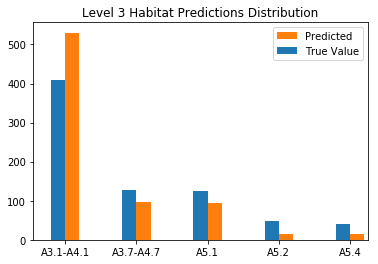

In [47]:
fig = plt.figure()

ax = fig.add_subplot(111) 
results.first_level3.value_counts().plot.bar(color='C1', align='center', label='Predicted', width=.2, position=0)
results.level3.replace(['A3.1', 'A4.1'], 'A3.1-A4.1').replace(['A3.7', 'A4.7'], 'A3.7-A4.7').value_counts().plot.bar(color='C0', align='center', label='True Value', width=.2, position=1)
plt.legend()
plt.xticks(rotation='horizontal')
plt.title('Level 3 Habitat Predictions Distribution')
plt.savefig('predicted_vs_true.jpg')
plt.show()


In [48]:
results.level3.value_counts()

A3.1    378
A5.1    125
A3.7    105
A5.2     49
A5.4     41
A4.1     30
A4.7     23
Name: level3, dtype: int64

In [49]:
y3_true = results.level3.replace(['A3.1', 'A4.1'], 'A3.1-A4.1').replace(['A3.7', 'A4.7'], 'A3.7-A4.7')
y3_pred = results.first_level3
print(classification_report(y3_true, y3_pred, labels=['A3.1-A4.1','A3.7-A4.7','A5.1','A5.2','A5.4']))

             precision    recall  f1-score   support

  A3.1-A4.1       0.69      0.90      0.78       408
  A3.7-A4.7       0.60      0.44      0.50       128
       A5.1       0.77      0.60      0.68       125
       A5.2       0.75      0.24      0.37        49
       A5.4       0.86      0.29      0.44        41

avg / total       0.70      0.70      0.67       751



In [50]:
accuracy_score(y3_true, y3_pred)

0.6964047936085219

In [51]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y3_true, y3_pred)

array([[368,  29,   8,   1,   2],
       [ 71,  56,   0,   1,   0],
       [ 47,   1,  75,   2,   0],
       [ 27,   8,   2,  12,   0],
       [ 17,   0,  12,   0,  12]])

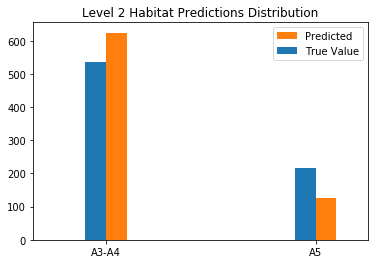

In [52]:
fig = plt.figure()

ax = fig.add_subplot(111) 
results.first_level2.value_counts().plot.bar(color='C1', position=0, label='Predicted', width=.1)
results.level2.replace(['A3', 'A4'], 'A3-A4').value_counts().plot.bar(color='C0', position=1, label='True Value', width=0.1)
plt.legend()
plt.title('Level 2 Habitat Predictions Distribution')
plt.xticks(rotation='horizontal')
plt.savefig('predicted_vs_true_lvl2.jpg')
plt.show()

In [53]:
y2_true = results.level2.replace(['A3', 'A4'],'A3-A4')
y2_pred = results.first_level2
print(classification_report(y2_true, y2_pred, labels=['A3-A4','A5']))

             precision    recall  f1-score   support

      A3-A4       0.84      0.98      0.90       536
         A5       0.91      0.53      0.67       215

avg / total       0.86      0.85      0.84       751



In [54]:
accuracy_score(y2_true, y2_pred)

0.8508655126498003

In [15]:
failed_lvl3 = results[results['first_level3'] != results['level3'].replace(['A3.1', 'A4.1'],'A3.1-A4.1').replace(['A3.7', 'A4.7'],'A3.7-A4.7')]
failed_lvl3.head()

,first_level3,second_level3,first_level2,second_level2,level3,level2
filename,,,,,,
105317_cam-np3_frame1347.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1352.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1538.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1544.jpg,A3.1-A4.1,A3.7-A4.7,A3-A4,A3-A4,A3.7,A3
105317_cam-np3_frame1619.jpg,A3.7-A4.7,A3.1-A4.1,A3-A4,A3-A4,A3.1,A3


In [16]:
df_fail3 = pd.concat([pd.get_dummies(failed_lvl3.first_level3),failed_lvl3.replace(['A3.1', 'A4.1'],'A3.1-A4.1').replace(['A3.7', 'A4.7'],'A3.7-A4.7').level3], axis=1).groupby('level3').sum()
#df_fail2 = pd.concat([pd.get_dummies(failed_lvl2.first_level2),failed_lvl2.replace(['A3', 'A4'],'A3-A4').level2], axis=1).groupby('level2').sum()


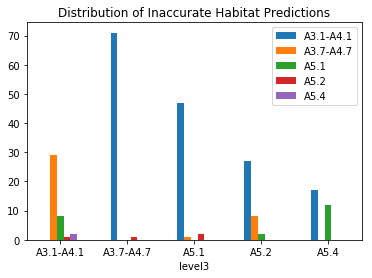

In [17]:
df_fail3.plot.bar()
plt.legend()
plt.xticks(rotation='horizontal')
plt.title('Distribution of Inaccurate Habitat Predictions')
plt.savefig('predicted_vs_true_per_class.jpg')
plt.show()

In [28]:
fnames = results.index
 
# Get the ground truth from generator
ground_truth = results.level3
 
 
 
errors = np.where(results.first_level3 != results.level3.replace(['A3.1', 'A4.1'], 'A3.1-A4.1').replace(['A3.7', 'A4.7'], 'A3.7-A4.7'))[0]
print("No of errors = {}/{}".format(len(errors),len(results)))
 


No of errors = 228/751


In [34]:
results.iloc[errors[0]]

first_level3     A3.1-A4.1
second_level3    A3.7-A4.7
first_level2         A3-A4
second_level2        A3-A4
level3                A3.7
level2                  A3
Name: 105317_cam-np3_frame1347.jpg, dtype: object

In [57]:

from keras.preprocessing.image import load_img

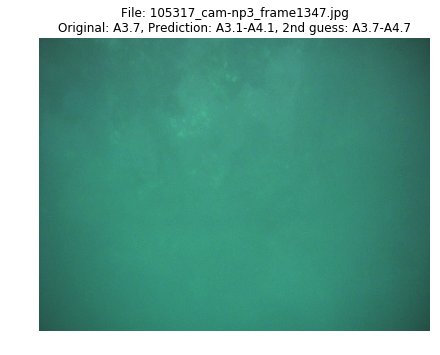

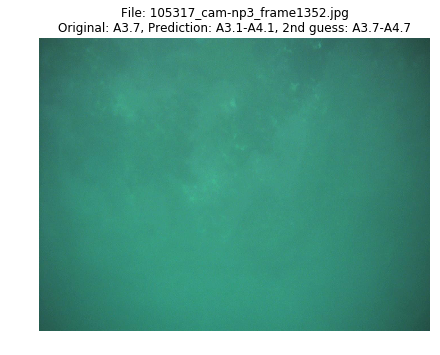

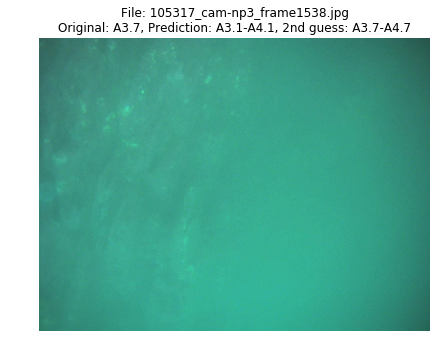

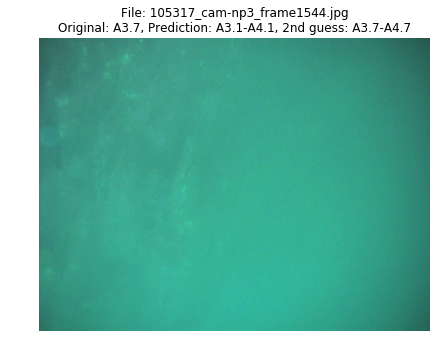

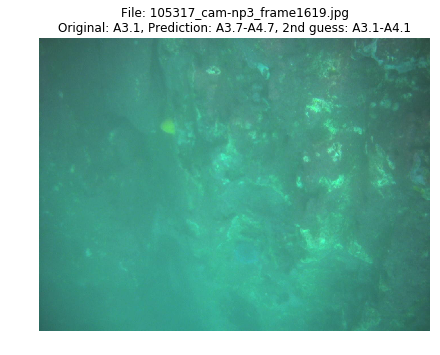

...

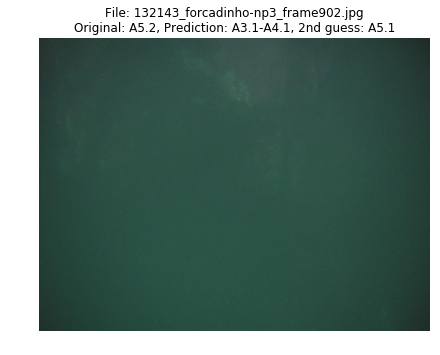

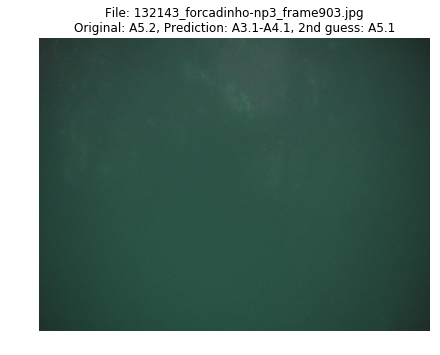

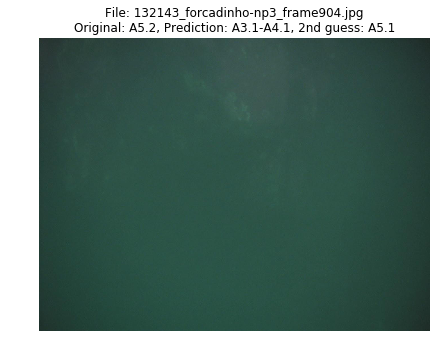

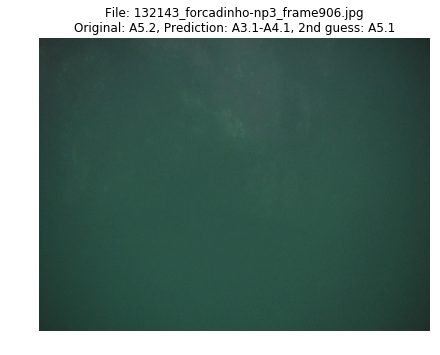

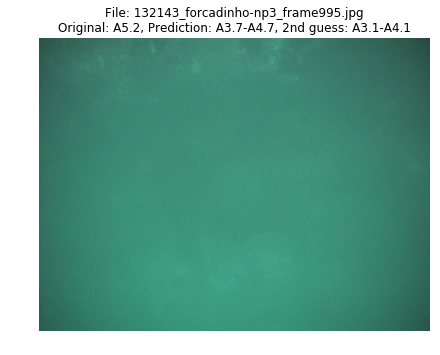

In [60]:
# Show the errors
for i in range(len(errors)):
    pred_class = results.iloc[errors[i]]
     
    title = 'File: {}\nOriginal: {}, Prediction: {}, 2nd guess: {}'.format(
        fnames[errors[i]],
        pred_class.level3,
        pred_class.first_level3,
        pred_class.second_level3)
     
    original = load_img('{}/{}'.format('/media/newdrive/20180501/ProcessedImages/test/unknown2',fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()